# Entrega 01 - Problema da Mochila com Algoritmo Genético

In [ ]:
import random

# Definindo os itens
itens = [
    {"nome": "Saco de dormir", "peso": 15, "pontos": 15},
    {"nome": "Corda", "peso": 3, "pontos": 7},
    {"nome": "Canivete", "peso": 2, "pontos": 10},
    {"nome": "Tocha", "peso": 5, "pontos": 5},
    {"nome": "Garrafa", "peso": 9, "pontos": 8},
    {"nome": "Comida", "peso": 20, "pontos": 17},
]

# Definindo os parâmetros do algoritmo genético
tamanho_populacao = 100
numero_geracoes = 50
taxa_mutacao = 0.1

# Função para gerar um cromossomo (uma solução)
def gerar_cromossomo():
    return [random.randint(0, 1) for _ in range(len(itens))]

# Função para calcular a aptidão de um cromossomo (o número de pontos de sobrevivência)
def calcular_aptidao(cromossomo):
    peso_total = 0
    pontos_totais = 0
    for i, item in enumerate(itens):
        if cromossomo[i] == 1:
            peso_total += item["peso"]
            pontos_totais += item["pontos"]
    if peso_total > 30:
        return 0
    return pontos_totais

# Função para selecionar os pais para reprodução
def selecionar_pais(populacao):
    pais = []
    for _ in range(2):
        pai1 = random.choice(populacao)
        pai2 = random.choice(populacao)
        while pai1 == pai2:
            pai2 = random.choice(populacao)
        pais.append((pai1, pai2))
    return pais

# Função para realizar o cruzamento entre dois pais
def realizar_cruzamento(pai1, pai2):
    filho1 = pai1[:]
    filho2 = pai2[:]
    ponto_corte = random.randint(1, len(pai1) - 1)
    filho1[ponto_corte:], filho2[ponto_corte:] = pai2[ponto_corte:], pai1[ponto_corte:]
    return filho1, filho2

# Função para realizar a mutação em um cromossomo
def realizar_mutacao(cromossomo):
    for i in range(len(cromossomo)):
        if random.random() < taxa_mutacao:
            cromossomo[i] = 1 - cromossomo[i]
    return cromossomo

# Função para executar o algoritmo genético
def executar_algoritmo_genetico():
    populacao = [gerar_cromossomo() for _ in range(tamanho_populacao)]
    for _ in range(numero_geracoes):
        pais = selecionar_pais(populacao)
        filhos = []
        for pai1, pai2 in pais:
            filho1, filho2 = realizar_cruzamento(pai1, pai2)
            filho1 = realizar_mutacao(filho1)
            filho2 = realizar_mutacao(filho2)
            filhos.append(filho1)
            filhos.append(filho2)
        populacao = sorted(populacao + filhos, key=calcular_aptidao, reverse=True)[:tamanho_populacao]
    return populacao[0]

# Executando o algoritmo genético
melhor_solucao = executar_algoritmo_genetico()

# Imprimindo a melhor solução
for i, item in enumerate(itens):
    if melhor_solucao[i] == 1:
        print(f" - {item['nome']}")

# Calculando o peso e os pontos da melhor solução
peso_total = 0
pontos_totais = 0
for i, item in enumerate(itens):
    if melhor_solucao[i] == 1:
        peso_total += item["peso"]
        pontos_totais += item["pontos"]

print(f"Peso total: {peso_total} kg")
print(f"Pontos totais: {pontos_totais}")


# Entrega 02 - Adicionando Estimação de Distribuição

 - Saco de dormir
 - Corda
 - Canivete
 - Garrafa
Peso total: 29 kg
Pontos totais: 40


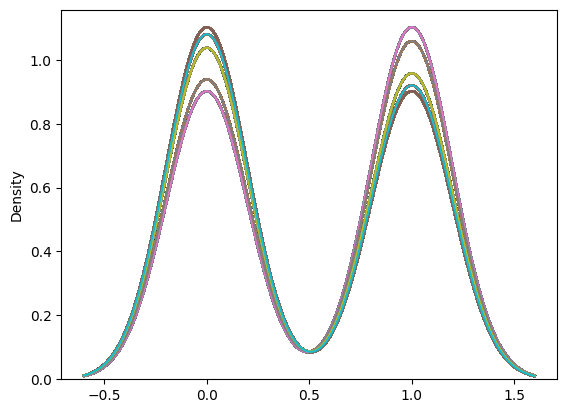

In [12]:
import random
import seaborn as sns
import numpy as np

# Definindo os itens
itens = [
    {"nome": "Saco de dormir", "peso": 15, "pontos": 15},
    {"nome": "Corda", "peso": 3, "pontos": 7},
    {"nome": "Canivete", "peso": 2, "pontos": 10},
    {"nome": "Tocha", "peso": 5, "pontos": 5},
    {"nome": "Garrafa", "peso": 9, "pontos": 8},
    {"nome": "Comida", "peso": 20, "pontos": 17},
]

# Definindo os parâmetros do algoritmo genético
tamanho_populacao = 100
numero_geracoes = 50
taxa_mutacao = 0.1

# Função para gerar um cromossomo (uma solução)
def gerar_cromossomo():
    return [random.randint(0, 1) for _ in range(len(itens))]

# Função para calcular a aptidão de um cromossomo (o número de pontos de sobrevivência)
def calcular_aptidao(cromossomo):
    peso_total = 0
    pontos_totais = 0
    for i, item in enumerate(itens):
        if cromossomo[i] == 1:
            peso_total += item["peso"]
            pontos_totais += item["pontos"]
    if peso_total > 30:
        return 0
    return pontos_totais

# Função para selecionar os pais para reprodução
def selecionar_pais(populacao):
    pais = []
    for _ in range(2):
        pai1 = random.choice(populacao)
        pai2 = random.choice(populacao)
        while pai1 == pai2:
            pai2 = random.choice(populacao)
        pais.append((pai1, pai2))
    return pais

# Função para realizar o cruzamento entre dois pais
def realizar_cruzamento(pai1, pai2):
    filho1 = pai1[:]
    filho2 = pai2[:]
    ponto_corte = random.randint(1, len(pai1) - 1)
    filho1[ponto_corte:], filho2[ponto_corte:] = pai2[ponto_corte:], pai1[ponto_corte:]
    return filho1, filho2

# Função para realizar a mutação em um cromossomo
def realizar_mutacao(cromossomo):
    for i in range(len(cromossomo)):
        if random.random() < taxa_mutacao:
            cromossomo[i] = 1 - cromossomo[i]
    return cromossomo

# Função para executar o algoritmo genético
def executar_algoritmo_genetico():
    populacao = [gerar_cromossomo() for _ in range(tamanho_populacao)]
    for _ in range(numero_geracoes):
        pais = selecionar_pais(populacao)
        filhos = []
        for pai1, pai2 in pais:
            filho1, filho2 = realizar_cruzamento(pai1, pai2)
            filho1 = realizar_mutacao(filho1)
            filho2 = realizar_mutacao(filho2)
            filhos.append(gerar_individuo_com_distribuicao(estimar_distribuicao(populacao)))
            filhos.append(gerar_individuo_com_distribuicao(estimar_distribuicao(populacao)))
    populacao = sorted(populacao + filhos, key=calcular_aptidao, reverse=True)[:tamanho_populacao]
    
    return populacao[0]

def estimar_distribuicao(populacao):
  # Estima a distribuição dos indivíduos da população usando KDE(Kernel Density Estimation) do seaborn.
  distribuicao = {}
  for i in range(len(populacao[0])):
        bit_array = np.array([individuo[i] for individuo in populacao])
        distribuicao_kde = sns.kdeplot(bit_array, fill=False)
        curva_probabilidade = distribuicao_kde.lines[0].get_data()
        probabilidade = {int(valor): prob for valor, prob in zip(curva_probabilidade[0], curva_probabilidade[1])}
        distribuicao[i] = probabilidade
  return distribuicao

def gerar_individuo_com_distribuicao(distribuicao):
  novo_individuo = []
  for i in range(len(distribuicao)):
    # Gera um número aleatório entre 0 e 1
    aleatorio = random.random()
    # Acumula as probabilidades
    probabilidade_acumulada = 0
    for valor, probabilidade in distribuicao[i].items():
      probabilidade_acumulada += probabilidade
      # Se o número aleatório for menor que a probabilidade acumulada, escolhe o valor
      if aleatorio <= probabilidade_acumulada:
        novo_individuo.append(valor)
        break
  return novo_individuo

# Executando o algoritmo genético
melhor_solucao = executar_algoritmo_genetico()

# Imprimindo a melhor solução
for i, item in enumerate(itens):
    if melhor_solucao[i] == 1:
        print(f" - {item['nome']}")

# Calculando o peso e os pontos da melhor solução
peso_total = 0
pontos_totais = 0
for i, item in enumerate(itens):
    if melhor_solucao[i] == 1:
        peso_total += item["peso"]
        pontos_totais += item["pontos"]

print(f"Peso total: {peso_total} kg")
print(f"Pontos totais: {pontos_totais}")


# Entrega 03 - Torre de Hanoi Recursiva

In [2]:
def torre_de_hanoi(n, origem, destino, auxiliar):
  if n == 1:
    # Caso base: mover um disco.
    print(f"Mover disco 1 de {origem} para {destino}")
  else:
    # Caso recursivo:
    # 1. Mover os n-1 discos de cima do maior disco da origem para o auxiliar.
    torre_de_hanoi(n-1, origem, auxiliar, destino)
    # 2. Mover o maior disco da origem para o destino.
    print(f"Mover disco {n} de {origem} para {destino}")
    # 3. Mover os n-1 discos do auxiliar para o destino.
    torre_de_hanoi(n-1, auxiliar, destino, origem)

# Número de discos
n = 20

# Pinos
origem = "A"
destino = "C"
auxiliar = "B"

# Resolver a Torre de Hanoi
torre_de_hanoi(n, origem, destino, auxiliar)


Mover disco 1 de A para B
Mover disco 2 de A para C
Mover disco 1 de B para C
Mover disco 3 de A para B
Mover disco 1 de C para A
Mover disco 2 de C para B
Mover disco 1 de A para B
Mover disco 4 de A para C
Mover disco 1 de B para C
Mover disco 2 de B para A
Mover disco 1 de C para A
Mover disco 3 de B para C
Mover disco 1 de A para B
Mover disco 2 de A para C
Mover disco 1 de B para C
Mover disco 5 de A para B
Mover disco 1 de C para A
Mover disco 2 de C para B
Mover disco 1 de A para B
Mover disco 3 de C para A
Mover disco 1 de B para C
Mover disco 2 de B para A
Mover disco 1 de C para A
Mover disco 4 de C para B
Mover disco 1 de A para B
Mover disco 2 de A para C
Mover disco 1 de B para C
Mover disco 3 de A para B
Mover disco 1 de C para A
Mover disco 2 de C para B
Mover disco 1 de A para B
Mover disco 6 de A para C
Mover disco 1 de B para C
Mover disco 2 de B para A
Mover disco 1 de C para A
Mover disco 3 de B para C
Mover disco 1 de A para B
Mover disco 2 de A para C
Mover disco 